In [8]:
# open the generated synthetic data file and read it as a python dictionary called data

import json

file = open('synthetic_dataset_with_time.txt', 'r')
text = file.read()
data = json.loads(text)


In [9]:
import emip_toolkit as EMTK

# find areas of interest (AOIs) once again
image_path = "./"
image = "synthetic_text.png"
aoi = EMTK.find_aoi(image, image_path, level="sub-line")


# add tokens to AOIs 
file_path = "./"
aois_with_tokens = EMTK.add_tokens_to_AOIs(file_path, image.split(".")[0]+".txt", aoi)
aois_with_tokens.head()


import correction

# find the y coordinate of each line in the text
line_ys = correction.find_lines_Y(aoi)

/Users/chandrachudgowda/Library/Mobile Documents/com~apple~CloudDocs/Colby/Spring 2023/CS421/CS421-project-cmg/emip_toolkit.py:1255: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  aoi = aoi.append(dic, ignore_index=True)
/Users/chandrachudgowda/Library/Mobile Documents/com~apple~CloudDocs/Colby/Spring 2023/CS421/CS421-project-cmg/emip_toolkit.py:1255: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  aoi = aoi.append(dic, ignore_index=True)
/Users/chandrachudgowda/Library/Mobile Documents/com~apple~CloudDocs/Colby/Spring 2023/CS421/CS421-project-cmg/emip_toolkit.py:1255: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  aoi = aoi.append(dic, ignore_index=True)
/Users/chandrachudgowda/Library/Mobile Documents/com~apple~CloudDocs/Colb

In [10]:
import numpy as np
import drift_algorithms as algo
from tqdm import tqdm

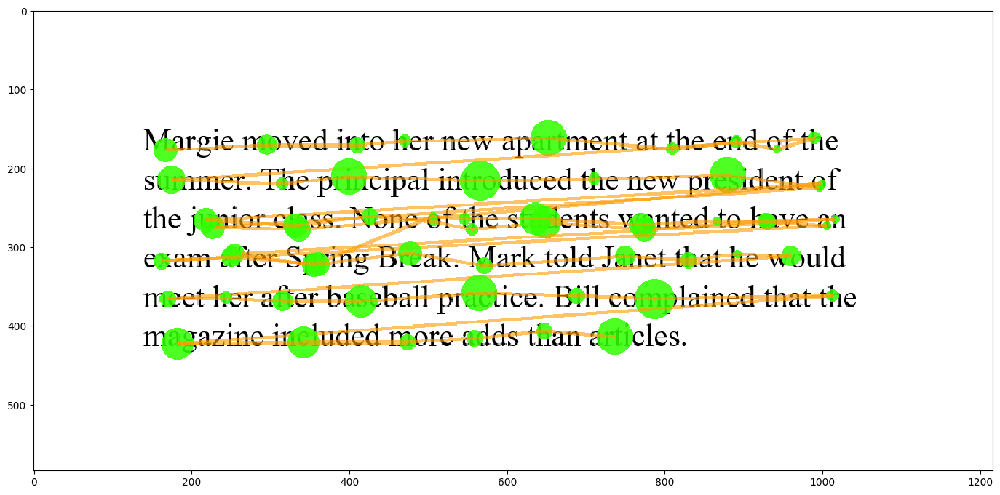

In [11]:
# draw original correct fixations

correction.draw_fixation('synthetic_text.png', data['robot1'].copy())

/Users/chandrachudgowda/Library/Mobile Documents/com~apple~CloudDocs/Colby/Spring 2023/CS421/CS421-project-cmg/emip_toolkit.py:1255: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  aoi = aoi.append(dic, ignore_index=True)
/Users/chandrachudgowda/Library/Mobile Documents/com~apple~CloudDocs/Colby/Spring 2023/CS421/CS421-project-cmg/emip_toolkit.py:1255: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  aoi = aoi.append(dic, ignore_index=True)
/Users/chandrachudgowda/Library/Mobile Documents/com~apple~CloudDocs/Colby/Spring 2023/CS421/CS421-project-cmg/emip_toolkit.py:1255: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  aoi = aoi.append(dic, ignore_index=True)
/Users/chandrachudgowda/Library/Mobile Documents/com~apple~CloudDocs/Colb

111
111


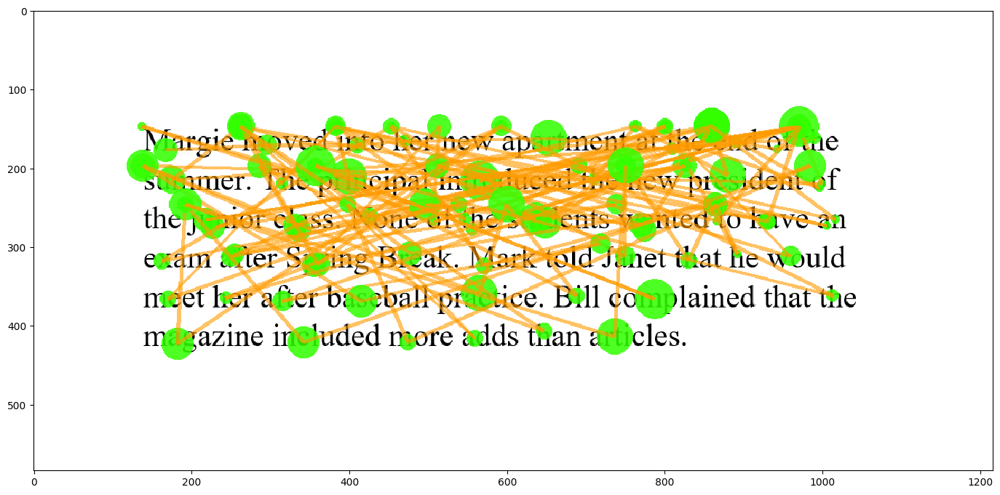

In [12]:
# generate between line regression error over the correct trial
image_path = "./"
image = "synthetic_text.png"
aoi_words = EMTK.find_aoi(image, image_path, level="sub-line")
aoi_lines = EMTK.find_aoi(image, image_path, level="line")

# Creating a sample lsit to store an array of an array of words where each index represents a line
words_sorted_by_line = []

for i in range(len(aoi_lines)):
    words_sorted_by_line.append([])

# Looping through the words and appending them to the correct line
for i in range(len(aoi_words)):
    word_line_number = int(aoi_words.at[i, 'name'].strip().split(' ')[1])
    # Appending the x and y coordinates of the word to the correct line
    words_sorted_by_line[word_line_number-1].append([aoi_words.at[i, 'x'], aoi_words.at[i, 'y']])

error_test, data['robot1'] = correction.error_between_line_regression(1, data['robot1'].copy(), words_sorted_by_line, aoi_lines)

# Printing the length of robot1 and error_test to check if the length of the two lists are the same
print(len(data['robot1']))
print(len(error_test))

# draw the trial with added error
correction.draw_fixation('synthetic_text.png', error_test)

0.5675675675675675
fixations:  111
match_list:  111


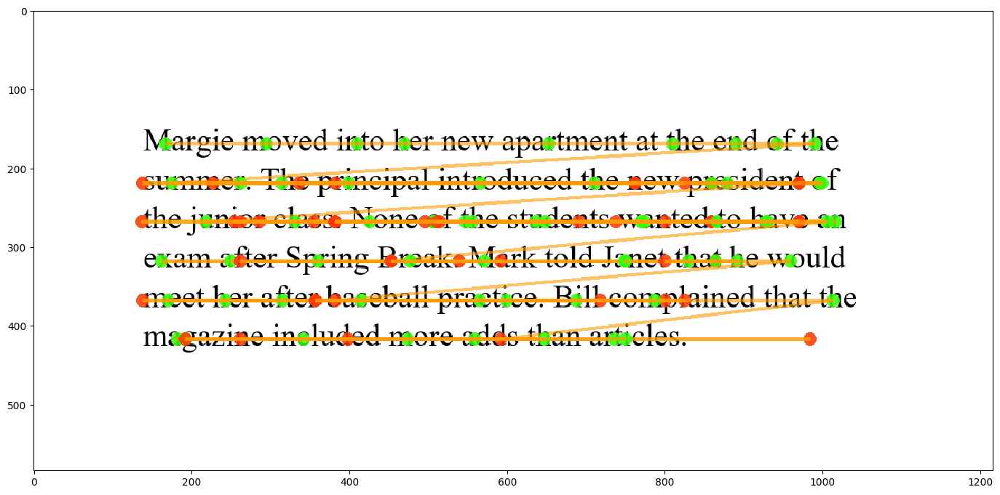

In [13]:
# find the center of each word, we need this for warp algorithm
word_centers = correction.find_word_centers(aoi)
word_centers = np.array(word_centers.copy(), dtype=int)

# warp correction
np_array = np.array(error_test.copy(), dtype=int)
durations = np.delete(np_array, 0, 1)
durations = np.delete(durations, 0, 1)
np_array = np.delete(np_array, 2, 1)

# run warp
warp_correction = algo.warp(np_array, word_centers)

# this is a cool function that checks the quality of the correction
percentage, match_list = correction.correction_quality(aoi, data['robot1'].copy(), warp_correction)
print(percentage)

# this is a cool function that draws the correction in red if the algorithm made a mistake
correction.draw_correction('synthetic_text.png', warp_correction, match_list)

This concludes the example I wanted to show you of running an error generator, then correcting the data, then seeing how well the correction algorithm did.  You will need to repeat the same concept for a bunch of algorithms in the next section.

# Comparing algorithms with Between Line regression error:

In [14]:
attach_results = [[],[],[],[],[],[],[],[],[],[],[]]
chain_results = [[],[],[],[],[],[],[],[],[],[],[]]
regress_results = [[],[],[],[],[],[],[],[],[],[],[]]
warp_results = [[],[],[],[],[],[],[],[],[],[],[]]
# Initializing the remaining 6 algorithms
cluster_results = [[],[],[],[],[],[],[],[],[],[],[]]
compare_results = [[],[],[],[],[],[],[],[],[],[],[]]
merge_results = [[],[],[],[],[],[],[],[],[],[],[]]
segment_results = [[],[],[],[],[],[],[],[],[],[],[]]
split_results = [[],[],[],[],[],[],[],[],[],[],[]]
stretch_results = [[],[],[],[],[],[],[],[],[],[],[]]

import json

file = open('synthetic_dataset_with_time.txt', 'r')
text = file.read()
data = json.loads(text)

word_centers = correction.find_word_centers(aoi)
word_centers = np.array(word_centers.copy(), dtype=int)

duration_word_centers = correction.find_word_centers_and_duration(aois_with_tokens)
duration_word_centers = np.array(duration_word_centers.copy(), dtype=int)

image_path = "./"
image = "synthetic_text.png"
aoi_words = EMTK.find_aoi(image, image_path, level="sub-line")
aoi_lines = EMTK.find_aoi(image, image_path, level="line")

# Creating a sample lsit to store an array of an array of words where each index represents a line
words_sorted_by_line = []

for i in range(len(aoi_lines)):
    words_sorted_by_line.append([])

# Looping through the words and appending them to the correct line
for i in range(len(aoi_words)):
    word_line_number = int(aoi_words.at[i, 'name'].strip().split(' ')[1])
    # Appending the x and y coordinates of the word to the correct line
    words_sorted_by_line[word_line_number-1].append([aoi_words.at[i, 'x'], aoi_words.at[i, 'y']])

# MAKE SURE YOU RUN THIS 100 TIMES, NOT JUST ONE!!!
for robot_index in tqdm(range(100)):

    data_copy = data['robot' + str(robot_index)].copy()
    
    for error_probability in range(0, 11):

        data['robot' + str(robot_index)] = data_copy.copy()

        # generate error for between line regression
        error_test, data['robot' + str(robot_index)] = correction.error_between_line_regression(error_probability/10, data['robot' + str(robot_index)].copy(), words_sorted_by_line, aoi_lines)

        # attach correction - 1
        np_array = np.array(error_test.copy())
        attach_correction = algo.attach(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), attach_correction)
        attach_results[error_probability].append(percentage)

        # chain correction - 2
        np_array = np.array(error_test.copy())
        chain_correction = algo.chain(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), chain_correction)
        chain_results[error_probability].append(percentage)
        
        # regress correction - 3
        np_array = np.array(error_test.copy())
        regress_correction = algo.regress(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), regress_correction)
        regress_results[error_probability].append(percentage)
        
        # warp correction - 4
        np_array = np.array(error_test.copy(), dtype=int)
        durations = np.delete(np_array, 0, 1)
        durations = np.delete(durations, 0, 1)
        np_array = np.delete(np_array, 2, 1)
        
        warp_correction = algo.warp(np_array, word_centers)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), warp_correction)
        warp_results[error_probability].append(percentage)

        if percentage < 1:
            # correction.draw_correction('synthetic_text.png', warp_correction, match_list)
            print("robot:", robot_index, "    error probability:", error_probability)

        # cluster correction - 5
        np_array = np.array(error_test.copy())
        cluster_correction = algo.cluster(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), cluster_correction)
        cluster_results[error_probability].append(percentage)

        # compare correction - 6 which takes in fixation_XY, word_XY
        np_array = np.array(error_test.copy())
        compare_correction = algo.compare(np_array, duration_word_centers)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), compare_correction)
        compare_results[error_probability].append(percentage)

        # merge correction - 7
        np_array = np.array(error_test.copy())
        merge_correction = algo.merge(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), merge_correction)
        merge_results[error_probability].append(percentage)

        # segment correction - 8
        np_array = np.array(error_test.copy())
        segment_correction = algo.segment(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), segment_correction)
        segment_results[error_probability].append(percentage)

        # split correction - 9
        np_array = np.array(error_test.copy())
        split_correction = algo.split(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), split_correction)
        split_results[error_probability].append(percentage)

        # stretch correction - 10
        np_array = np.array(error_test.copy())
        stretch_correction = algo.stretch(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), stretch_correction)
        stretch_results[error_probability].append(percentage)


/Users/chandrachudgowda/Library/Mobile Documents/com~apple~CloudDocs/Colby/Spring 2023/CS421/CS421-project-cmg/emip_toolkit.py:1255: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  aoi = aoi.append(dic, ignore_index=True)
/Users/chandrachudgowda/Library/Mobile Documents/com~apple~CloudDocs/Colby/Spring 2023/CS421/CS421-project-cmg/emip_toolkit.py:1255: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  aoi = aoi.append(dic, ignore_index=True)
/Users/chandrachudgowda/Library/Mobile Documents/com~apple~CloudDocs/Colby/Spring 2023/CS421/CS421-project-cmg/emip_toolkit.py:1255: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  aoi = aoi.append(dic, ignore_index=True)
/Users/chandrachudgowda/Library/Mobile Documents/com~apple~CloudDocs/Colb

robot: 0     error probability: 0
robot: 0     error probability: 1
robot: 0     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 0     error probability: 3
robot: 0     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 0     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 0     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 0     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 0     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 0     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 0     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 1     error probability: 0
robot: 1     error probability: 1
robot: 1     error probability: 2
robot: 1     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 1     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 1     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 1     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 1     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 1     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 1     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 1     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 2     error probability: 1
robot: 2     error probability: 2
robot: 2     error probability: 3
robot: 2     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 2     error probability: 5
robot: 2     error probability: 6
robot: 2     error probability: 7
robot: 2     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 2     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 2     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 3     error probability: 0
robot: 3     error probability: 1
robot: 3     error probability: 2
robot: 3     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 3     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 3     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 3     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 3     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 3     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 3     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 3     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 4     error probability: 0
robot: 4     error probability: 1
robot: 4     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 4     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 4     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 4     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 4     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 4     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 4     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 4     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 4     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 5     error probability: 1


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 5     error probability: 2
robot: 5     error probability: 3
robot: 5     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 5     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 5     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 5     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 5     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 5     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 5     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 6     error probability: 0
robot: 6     error probability: 1
robot: 6     error probability: 2
robot: 6     error probability: 3
robot: 6     error probability: 4
robot: 6     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 6     error probability: 6
robot: 6     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 6     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 6     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 6     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 7     error probability: 1
robot: 7     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 7     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 7     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 7     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 7     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 7     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 7     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 7     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 7     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 8     error probability: 0
robot: 8     error probability: 1
robot: 8     error probability: 2
robot: 8     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 8     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 8     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 8     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 8     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 8     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 8     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 8     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 9     error probability: 0
robot: 9     error probability: 1
robot: 9     error probability: 2
robot: 9     error probability: 3
robot: 9     error probability: 4
robot: 9     error probability: 5
robot: 9     error probability: 6
robot: 9     error probability: 7
robot: 9     error probability: 8
robot: 9     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 9     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 10     error probability: 1
robot: 10     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 10     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 10     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 10     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 10     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 10     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 10     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 10     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 10     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 11     error probability: 0
robot: 11     error probability: 1
robot: 11     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 11     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 11     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 11     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 11     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 11     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 11     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 11     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 11     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 12     error probability: 0
robot: 12     error probability: 1
robot: 12     error probability: 2
robot: 12     error probability: 3
robot: 12     error probability: 4
robot: 12     error probability: 5
robot: 12     error probability: 6
robot: 12     error probability: 7
robot: 12     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 12     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 12     error probability: 10


 13%|█▎        | 13/100 [04:25<29:24, 20.29s/it]

robot: 13     error probability: 1
robot: 13     error probability: 2
robot: 13     error probability: 3
robot: 13     error probability: 4
robot: 13     error probability: 5
robot: 13     error probability: 6
robot: 13     error probability: 7
robot: 13     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 13     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 13     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 14     error probability: 0
robot: 14     error probability: 1
robot: 14     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 14     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 14     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 14     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 14     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 14     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 14     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 14     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 14     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 15     error probability: 1
robot: 15     error probability: 2
robot: 15     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 15     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 15     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 15     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 15     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 15     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 15     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 15     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 16     error probability: 0
robot: 16     error probability: 1
robot: 16     error probability: 2
robot: 16     error probability: 3
robot: 16     error probability: 4
robot: 16     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 16     error probability: 6
robot: 16     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 16     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 16     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 16     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 17     error probability: 1
robot: 17     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 17     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 17     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 17     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 17     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 17     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 17     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 17     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 17     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 18     error probability: 1
robot: 18     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 18     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 18     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 18     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 18     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 18     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 18     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 18     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 18     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 19     error probability: 0
robot: 19     error probability: 1
robot: 19     error probability: 2
robot: 19     error probability: 3
robot: 19     error probability: 4
robot: 19     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 19     error probability: 6
robot: 19     error probability: 7
robot: 19     error probability: 8
robot: 19     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 19     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 20     error probability: 0
robot: 20     error probability: 1
robot: 20     error probability: 2
robot: 20     error probability: 3
robot: 20     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 20     error probability: 5
robot: 20     error probability: 6
robot: 20     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 20     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 20     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 20     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 21     error probability: 1
robot: 21     error probability: 2
robot: 21     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 21     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 21     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 21     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 21     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 21     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 21     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 21     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 22     error probability: 0
robot: 22     error probability: 1
robot: 22     error probability: 2
robot: 22     error probability: 3
robot: 22     error probability: 4
robot: 22     error probability: 5
robot: 22     error probability: 6
robot: 22     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 22     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 22     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 22     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 23     error probability: 0
robot: 23     error probability: 1
robot: 23     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 23     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 23     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 23     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 23     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 23     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 23     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 23     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 23     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 24     error probability: 1
robot: 24     error probability: 2
robot: 24     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 24     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 24     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 24     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 24     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 24     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 24     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 24     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 25     error probability: 1
robot: 25     error probability: 2
robot: 25     error probability: 3
robot: 25     error probability: 4
robot: 25     error probability: 5
robot: 25     error probability: 6
robot: 25     error probability: 7
robot: 25     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 25     error probability: 9
robot: 25     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 26     error probability: 1
robot: 26     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 26     error probability: 3
robot: 26     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 26     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 26     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 26     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 26     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 26     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 26     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 27     error probability: 0
robot: 27     error probability: 1
robot: 27     error probability: 2
robot: 27     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 27     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 27     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 27     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 27     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 27     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 27     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 27     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 28     error probability: 0
robot: 28     error probability: 1
robot: 28     error probability: 2
robot: 28     error probability: 3
robot: 28     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 28     error probability: 5
robot: 28     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 28     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 28     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 28     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 28     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 29     error probability: 1
robot: 29     error probability: 2
robot: 29     error probability: 3
robot: 29     error probability: 4
robot: 29     error probability: 5
robot: 29     error probability: 6
robot: 29     error probability: 7
robot: 29     error probability: 8
robot: 29     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 29     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 30     error probability: 1
robot: 30     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 30     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 30     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 30     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 30     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 30     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 30     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 30     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 30     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 31     error probability: 1
robot: 31     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 31     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 31     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 31     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 31     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 31     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 31     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 31     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 31     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 32     error probability: 0
robot: 32     error probability: 1
robot: 32     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 32     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 32     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 32     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 32     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 32     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 32     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 32     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 32     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 33     error probability: 1
robot: 33     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 33     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 33     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 33     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 33     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 33     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 33     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 33     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 33     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 34     error probability: 1
robot: 34     error probability: 2
robot: 34     error probability: 3
robot: 34     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 34     error probability: 5
robot: 34     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 34     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 34     error probability: 8
robot: 34     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 34     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 35     error probability: 1
robot: 35     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 35     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 35     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 35     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 35     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 35     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 35     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 35     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 35     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 36     error probability: 1
robot: 36     error probability: 2
robot: 36     error probability: 3
robot: 36     error probability: 4
robot: 36     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 36     error probability: 6
robot: 36     error probability: 7
robot: 36     error probability: 8
robot: 36     error probability: 9
robot: 36     error probability: 10


 37%|███▋      | 37/100 [12:08<21:09, 20.15s/it]

robot: 37     error probability: 0
robot: 37     error probability: 1
robot: 37     error probability: 2
robot: 37     error probability: 3
robot: 37     error probability: 4
robot: 37     error probability: 5
robot: 37     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 37     error probability: 7
robot: 37     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 37     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 37     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
 38%|███▊      | 38/100 [12:27<20:35, 19.92s/it]

robot: 38     error probability: 0
robot: 38     error probability: 1


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 38     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 38     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 38     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 38     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 38     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 38     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 38     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 38     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 38     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 39     error probability: 0
robot: 39     error probability: 1
robot: 39     error probability: 2
robot: 39     error probability: 3
robot: 39     error probability: 4
robot: 39     error probability: 5
robot: 39     error probability: 6
robot: 39     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 39     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 39     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 39     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 40     error probability: 0
robot: 40     error probability: 1
robot: 40     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 40     error probability: 3
robot: 40     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 40     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 40     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 40     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 40     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 40     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 40     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 41     error probability: 0
robot: 41     error probability: 1
robot: 41     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 41     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 41     error probability: 4
robot: 41     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 41     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 41     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 41     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 41     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 41     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 42     error probability: 0
robot: 42     error probability: 1
robot: 42     error probability: 2
robot: 42     error probability: 3
robot: 42     error probability: 4
robot: 42     error probability: 5
robot: 42     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 42     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 42     error probability: 8
robot: 42     error probability: 9
robot: 42     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 43     error probability: 0
robot: 43     error probability: 1
robot: 43     error probability: 2
robot: 43     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 43     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 43     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 43     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 43     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 43     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 43     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 43     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 44     error probability: 1


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 44     error probability: 2
robot: 44     error probability: 3
robot: 44     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 44     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 44     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 44     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 44     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 44     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 44     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 45     error probability: 1
robot: 45     error probability: 2
robot: 45     error probability: 3
robot: 45     error probability: 4
robot: 45     error probability: 5
robot: 45     error probability: 6
robot: 45     error probability: 7
robot: 45     error probability: 8
robot: 45     error probability: 9
robot: 45     error probability: 10


 46%|████▌     | 46/100 [15:44<20:06, 22.35s/it]

robot: 46     error probability: 0
robot: 46     error probability: 1
robot: 46     error probability: 2
robot: 46     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 46     error probability: 4
robot: 46     error probability: 5
robot: 46     error probability: 6
robot: 46     error probability: 7
robot: 46     error probability: 8
robot: 46     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 46     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 47     error probability: 1
robot: 47     error probability: 2
robot: 47     error probability: 3
robot: 47     error probability: 4
robot: 47     error probability: 5
robot: 47     error probability: 6
robot: 47     error probability: 7
robot: 47     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 47     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 47     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 48     error probability: 0
robot: 48     error probability: 1


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 48     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 48     error probability: 3
robot: 48     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 48     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 48     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 48     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 48     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 48     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 48     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 49     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 49     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 49     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 49     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 49     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 49     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 49     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 49     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 49     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 50     error probability: 1
robot: 50     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 50     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 50     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 50     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 50     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 50     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 50     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 50     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 50     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 51     error probability: 0
robot: 51     error probability: 1
robot: 51     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 51     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 51     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 51     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 51     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 51     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 51     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 51     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 51     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 52     error probability: 1


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 52     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 52     error probability: 3
robot: 52     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 52     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 52     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 52     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 52     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 52     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 52     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 53     error probability: 0
robot: 53     error probability: 1
robot: 53     error probability: 2
robot: 53     error probability: 3
robot: 53     error probability: 4
robot: 53     error probability: 5
robot: 53     error probability: 6
robot: 53     error probability: 7
robot: 53     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 53     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 53     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 54     error probability: 1
robot: 54     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 54     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 54     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 54     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 54     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 54     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 54     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 54     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 54     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 55     error probability: 1
robot: 55     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 55     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 55     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 55     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 55     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 55     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 55     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 55     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 55     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 56     error probability: 0
robot: 56     error probability: 1
robot: 56     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 56     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 56     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 56     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 56     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 56     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 56     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 56     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 56     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 57     error probability: 1


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 57     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 57     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 57     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 57     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 57     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 57     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 57     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 57     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 57     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 58     error probability: 0
robot: 58     error probability: 1
robot: 58     error probability: 2
robot: 58     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 58     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 58     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 58     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 58     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 58     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 58     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 58     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 59     error probability: 0
robot: 59     error probability: 1


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 59     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 59     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 59     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 59     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 59     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 59     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 59     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 59     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 59     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 60     error probability: 1
robot: 60     error probability: 2
robot: 60     error probability: 3
robot: 60     error probability: 4
robot: 60     error probability: 5
robot: 60     error probability: 6
robot: 60     error probability: 7
robot: 60     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 60     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 60     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 61     error probability: 0
robot: 61     error probability: 1
robot: 61     error probability: 2
robot: 61     error probability: 3
robot: 61     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 61     error probability: 5
robot: 61     error probability: 6
robot: 61     error probability: 7
robot: 61     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 61     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 61     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 62     error probability: 0
robot: 62     error probability: 1
robot: 62     error probability: 2
robot: 62     error probability: 3
robot: 62     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 62     error probability: 5
robot: 62     error probability: 6
robot: 62     error probability: 7
robot: 62     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 62     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 62     error probability: 10


 63%|██████▎   | 63/100 [21:56<15:33, 25.22s/it]

robot: 63     error probability: 0
robot: 63     error probability: 1
robot: 63     error probability: 2
robot: 63     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 63     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 63     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 63     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 63     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 63     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 63     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 63     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 64     error probability: 0
robot: 64     error probability: 1
robot: 64     error probability: 2
robot: 64     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 64     error probability: 4
robot: 64     error probability: 5
robot: 64     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 64     error probability: 7
robot: 64     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 64     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 64     error probability: 10


 65%|██████▌   | 65/100 [22:46<14:35, 25.01s/it]

robot: 65     error probability: 1
robot: 65     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 65     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 65     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 65     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 65     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 65     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 65     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 65     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 65     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 66     error probability: 1
robot: 66     error probability: 2
robot: 66     error probability: 3
robot: 66     error probability: 4
robot: 66     error probability: 5
robot: 66     error probability: 6
robot: 66     error probability: 7
robot: 66     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 66     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 66     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 67     error probability: 0
robot: 67     error probability: 1
robot: 67     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 67     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 67     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 67     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 67     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 67     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 67     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 67     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 67     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 68     error probability: 0
robot: 68     error probability: 1
robot: 68     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 68     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 68     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 68     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 68     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 68     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 68     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 68     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 68     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 69     error probability: 1
robot: 69     error probability: 2
robot: 69     error probability: 3
robot: 69     error probability: 4
robot: 69     error probability: 5
robot: 69     error probability: 6
robot: 69     error probability: 7
robot: 69     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 69     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 69     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 70     error probability: 1
robot: 70     error probability: 2
robot: 70     error probability: 3
robot: 70     error probability: 4
robot: 70     error probability: 5
robot: 70     error probability: 6
robot: 70     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 70     error probability: 8
robot: 70     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 70     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 71     error probability: 1


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 71     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 71     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 71     error probability: 4
robot: 71     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 71     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 71     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 71     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 71     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 71     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 72     error probability: 1


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 72     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 72     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 72     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 72     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 72     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 72     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 72     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 72     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 72     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 73     error probability: 1
robot: 73     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 73     error probability: 3
robot: 73     error probability: 4
robot: 73     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 73     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 73     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 73     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 73     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 73     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 74     error probability: 0
robot: 74     error probability: 1


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 74     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 74     error probability: 3
robot: 74     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 74     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 74     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 74     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 74     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 74     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 74     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 75     error probability: 0
robot: 75     error probability: 1
robot: 75     error probability: 2
robot: 75     error probability: 3
robot: 75     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 75     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 75     error probability: 6
robot: 75     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 75     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 75     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 75     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 76     error probability: 1
robot: 76     error probability: 2
robot: 76     error probability: 3
robot: 76     error probability: 4
robot: 76     error probability: 5
robot: 76     error probability: 6
robot: 76     error probability: 7
robot: 76     error probability: 8
robot: 76     error probability: 9
robot: 76     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 77     error probability: 0
robot: 77     error probability: 1


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 77     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 77     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 77     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 77     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 77     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 77     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 77     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 77     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 77     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 78     error probability: 1
robot: 78     error probability: 2
robot: 78     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 78     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 78     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 78     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 78     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 78     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 78     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 78     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 79     error probability: 0
robot: 79     error probability: 1
robot: 79     error probability: 2
robot: 79     error probability: 3
robot: 79     error probability: 4
robot: 79     error probability: 5
robot: 79     error probability: 6
robot: 79     error probability: 7
robot: 79     error probability: 8
robot: 79     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 79     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
 80%|████████  | 80/100 [28:30<08:25, 25.28s/it]

robot: 80     error probability: 0
robot: 80     error probability: 1
robot: 80     error probability: 2
robot: 80     error probability: 3
robot: 80     error probability: 4
robot: 80     error probability: 5
robot: 80     error probability: 6
robot: 80     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 80     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 80     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 80     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 81     error probability: 0
robot: 81     error probability: 1
robot: 81     error probability: 2
robot: 81     error probability: 3
robot: 81     error probability: 4
robot: 81     error probability: 5
robot: 81     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 81     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 81     error probability: 8
robot: 81     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 81     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 82     error probability: 2
robot: 82     error probability: 3
robot: 82     error probability: 4
robot: 82     error probability: 5
robot: 82     error probability: 6
robot: 82     error probability: 7
robot: 82     error probability: 8
robot: 82     error probability: 9
robot: 82     error probability: 10


 83%|████████▎ | 83/100 [29:37<06:20, 22.38s/it]

robot: 83     error probability: 0
robot: 83     error probability: 1


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 83     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 83     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 83     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 83     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 83     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 83     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 83     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 83     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 83     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 84     error probability: 0
robot: 84     error probability: 1
robot: 84     error probability: 2
robot: 84     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 84     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 84     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 84     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 84     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 84     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 84     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 84     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 85     error probability: 0
robot: 85     error probability: 1
robot: 85     error probability: 2
robot: 85     error probability: 3
robot: 85     error probability: 4
robot: 85     error probability: 5
robot: 85     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 85     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 85     error probability: 8
robot: 85     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 85     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
 86%|████████▌ | 86/100 [30:47<05:20, 22.87s/it]

robot: 86     error probability: 0
robot: 86     error probability: 1
robot: 86     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 86     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 86     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 86     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 86     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 86     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 86     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 86     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 86     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 87     error probability: 1


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 87     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 87     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 87     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 87     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 87     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 87     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 87     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 87     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 87     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 88     error probability: 1
robot: 88     error probability: 2
robot: 88     error probability: 3
robot: 88     error probability: 4
robot: 88     error probability: 5
robot: 88     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 88     error probability: 7
robot: 88     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 88     error probability: 9
robot: 88     error probability: 10


 89%|████████▉ | 89/100 [31:45<03:36, 19.67s/it]

robot: 89     error probability: 0
robot: 89     error probability: 1
robot: 89     error probability: 2
robot: 89     error probability: 3
robot: 89     error probability: 4
robot: 89     error probability: 5
robot: 89     error probability: 6
robot: 89     error probability: 7
robot: 89     error probability: 8
robot: 89     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 89     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 90     error probability: 1
robot: 90     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 90     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 90     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 90     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 90     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 90     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 90     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 90     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 90     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 91     error probability: 1


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 91     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 91     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 91     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 91     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 91     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 91     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 91     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 91     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 91     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 92     error probability: 0
robot: 92     error probability: 1
robot: 92     error probability: 2
robot: 92     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 92     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 92     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 92     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 92     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 92     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 92     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 92     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 93     error probability: 1
robot: 93     error probability: 2
robot: 93     error probability: 3
robot: 93     error probability: 4
robot: 93     error probability: 5
robot: 93     error probability: 6
robot: 93     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 93     error probability: 8
robot: 93     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 93     error probability: 10


 94%|█████████▍| 94/100 [33:42<02:10, 21.80s/it]

robot: 94     error probability: 0
robot: 94     error probability: 1
robot: 94     error probability: 2
robot: 94     error probability: 3
robot: 94     error probability: 4
robot: 94     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 94     error probability: 6
robot: 94     error probability: 7
robot: 94     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 94     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 94     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 95     error probability: 1


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 95     error probability: 2
robot: 95     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 95     error probability: 4
robot: 95     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 95     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 95     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 95     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 95     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 95     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 96     error probability: 0
robot: 96     error probability: 1
robot: 96     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 96     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 96     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 96     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 96     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 96     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 96     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 96     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 96     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 97     error probability: 0
robot: 97     error probability: 1


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 97     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 97     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 97     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 97     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 97     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 97     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 97     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 97     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 97     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 98     error probability: 1
robot: 98     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 98     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 98     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 98     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 98     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 98     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 98     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 98     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 98     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 99     error probability: 1
robot: 99     error probability: 2


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 99     error probability: 3


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 99     error probability: 4


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 99     error probability: 5


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 99     error probability: 6


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 99     error probability: 7


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)


robot: 99     error probability: 8


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 99     error probability: 9


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

robot: 99     error probability: 10


/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWarning: Polyfit may be poorly conditioned
  merge_correction = algo.merge(np_array, line_ys)
/var/folders/10/n4knghmx6ks_bqbcwt45r8k00000gn/T/ipykernel_42630/1352099479.py:100: RankWa

In [15]:
import statistics

def mean_error_group(results):
    new_list = []
    
    for result in results:
        new_list.append(statistics.mean(result))
        
    return new_list

In [16]:
mean_attach_results = mean_error_group(attach_results)
mean_chain_results = mean_error_group(chain_results)
mean_regress_results = mean_error_group(regress_results)
mean_warp_results = mean_error_group(warp_results)
mean_cluster_results = mean_error_group(cluster_results)
mean_compare_results = mean_error_group(compare_results)
mean_merge_results = mean_error_group(merge_results)
mean_segment_results = mean_error_group(segment_results)
mean_split_results = mean_error_group(split_results)
mean_stretch_results = mean_error_group(stretch_results)

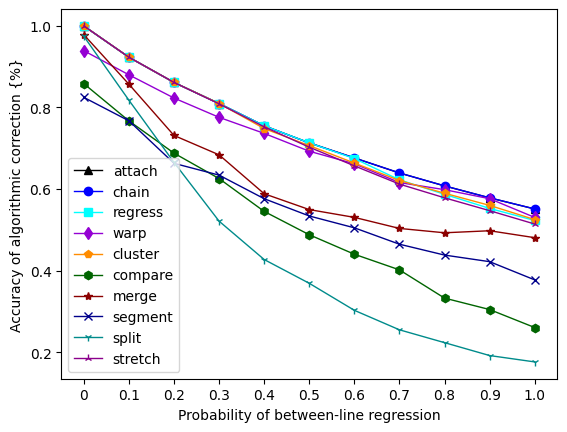

In [17]:
import matplotlib.pyplot as plt
plt.plot(mean_attach_results, color='Black', linewidth=1, marker='^')
plt.plot(mean_chain_results, color='Blue', linewidth=1, marker='o')
plt.plot(mean_regress_results, color='Aqua', linewidth=1, marker='s')
plt.plot(mean_warp_results, color='DarkViolet', linewidth=1, marker='d')
plt.plot(mean_cluster_results, color='DarkOrange', linewidth=1, marker='p')
plt.plot(mean_compare_results, color='DarkGreen', linewidth=1, marker='h')
plt.plot(mean_merge_results, color='DarkRed', linewidth=1, marker='*')
plt.plot(mean_segment_results, color='DarkBlue', linewidth=1, marker='x')
plt.plot(mean_split_results, color='DarkCyan', linewidth=1, marker='1')
plt.plot(mean_stretch_results, color='DarkMagenta', linewidth=1, marker='2')

plt.legend(['attach', 'chain', 'regress', 'warp', 'cluster', 'compare', 'merge', 'segment', 'split', 'stretch'])
plt.ylabel('Accuracy of algorithmic correction {%}')
plt.xlabel('Probability of between-line regression')

x_ticks_labels = ['0', '0.1', '0.2', '0.3', '0.4', '0.5', '0.6', '0.7', '0.8', '0.9', '1.0']
plt.xticks(range(0, 11), x_ticks_labels)
#plt.savefig("noise_comparison.png")
plt.show()

In [18]:
print("mean attach:", statistics.mean(mean_attach_results))
print("mean chain:", statistics.mean(mean_chain_results))
print("mean regress:", statistics.mean(mean_regress_results))
print("mean warp:", statistics.mean(mean_warp_results))
print("mean cluster:", statistics.mean(mean_cluster_results))
print("mean compare:", statistics.mean(mean_compare_results))
print("mean merge:", statistics.mean(mean_merge_results))
print("mean segment:", statistics.mean(mean_segment_results))
print("mean split:", statistics.mean(mean_split_results))
print("mean stretch:", statistics.mean(mean_stretch_results))

mean attach: 0.7378406547679223
mean chain: 0.7377666952502762
mean regress: 0.7293844836242451
mean warp: 0.7119241314487715
mean cluster: 0.7281076408602415
mean compare: 0.519336633780823
mean merge: 0.6268050210019991
mean segment: 0.5642947784222418
mean split: 0.4476922733785617
mean stretch: 0.7234566839405939
